# Advanced Lane Finding Workspace


In [1]:
#Imports
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
import glob
import collections

%matplotlib inline  


In [2]:
#Lane Class definition
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = collections.deque()
        self.best_fit_avg = None
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float')
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
        

## Calibration

In [3]:
cal_images = []
cal_filenames = []
#Import images
for img in glob.glob('./camera_cal/*.jpg'):
    image = cv2.imread(img)
    cal_images.append(image)
    cal_filenames.append(img)
    
#print(cal_filenames)
    
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.
#Process each cal image
for img in cal_images:
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)
    if ret:
        objpoints.append(objp)
        imgpoints.append(corners)

        
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
        
def undistort_image(img):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

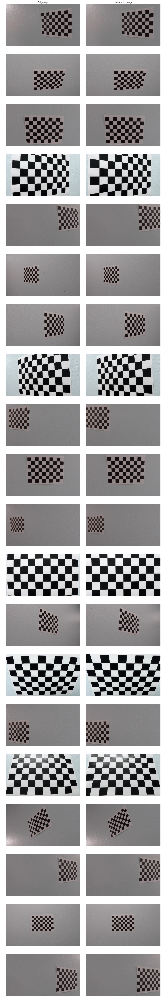

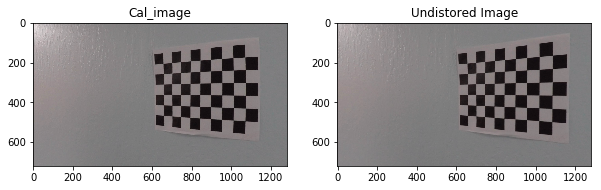

In [4]:
# Plot and compare original and distorted images
fig, ax = plt.subplots(len(cal_images), 2, figsize=(13, 80))
ax[0][0].set_title('Cal_image')
ax[0][1].set_title('Undistored Image')
for i, img in enumerate(cal_images):
    ax[i][0].imshow(img)
    ax[i][0].axis('off')
    undist = undistort_image(img)
    ax[i][1].imshow(undist)
    ax[i][1].axis('off')
    
plt.tight_layout()
#plt.savefig('./figs/chessboard.png')

fig, ax2 = plt.subplots(1, 2, figsize=(10, 3))
ax2[0].set_title('Cal_image')
ax2[1].set_title('Undistored Image')
ax2[0].imshow(cal_images[0])
ax2[1].imshow(undistort_image(cal_images[0]))
plt.savefig('./figs/chessboard.png')

## Test Images

In [5]:
test_images = []
test_filenames = []
#Import images
for img in glob.glob('./test_images/*.jpg'):
    image = cv2.imread(img, cv2.IMREAD_COLOR)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    test_images.append(image)
    test_filenames.append(img)
print(test_images[0].shape)

(720, 1280, 3)


## Undistort Image

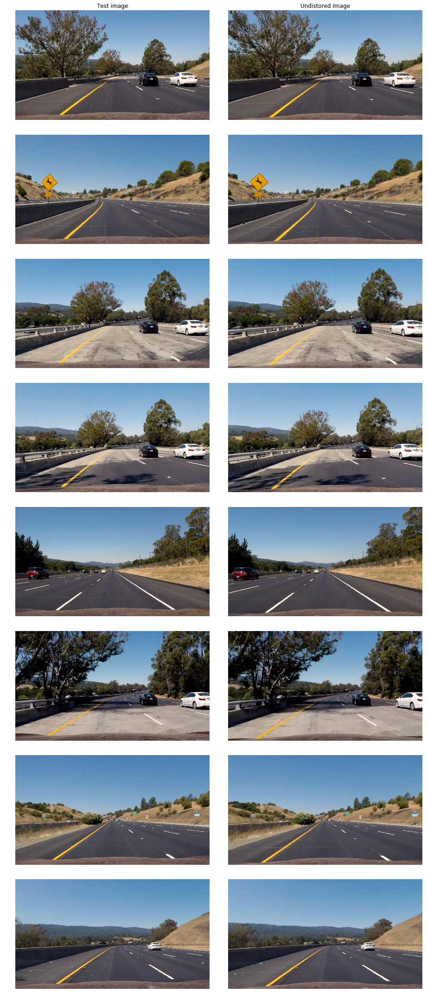

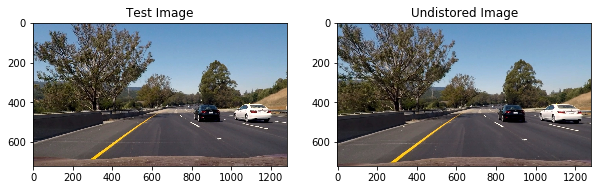

In [6]:
# Plot and compare original and distorted images
fig, ax = plt.subplots(len(test_images), 2, figsize=(13, 30))
ax[0][0].set_title('Test image')
ax[0][1].set_title('Undistored Image')
undist_images = []
for i, img in enumerate(test_images):
    ax[i][0].imshow(img)
    ax[i][0].axis('off')
    undist = undistort_image(img)
    ax[i][1].imshow(undist)
    ax[i][1].axis('off')
    undist_images.append(undist)

plt.tight_layout()
# plt.savefig('./figs/test_images_undist.png')

plt.figure()
fig, ax2 = plt.subplots(1, 2, figsize=(10, 3))
ax2[0].set_title('Test Image')
ax2[1].set_title('Undistored Image')
ax2[0].imshow(test_images[0])
ax2[1].imshow(undist_images[0])
plt.savefig('./figs/test_images_undist.png')

## Perspective Transform

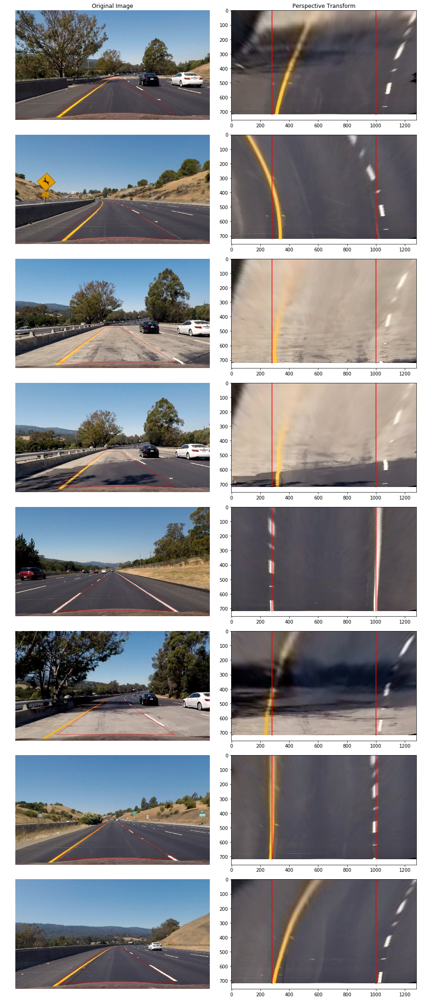

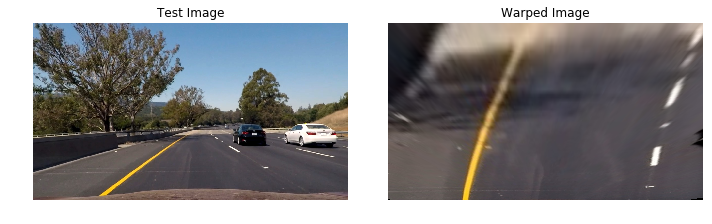

In [7]:
def perspective_transform(img, img_size,M):
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return warped

test_image = test_images[0]
test_image_size = test_image.shape[1::-1]
M = test_image_size[0]
N = test_image_size[1]

# [bottom left,
# top left, 
# top right, 
# bottom right]
src = np.float32(
    [[273, 680],
    [595, 450],
    [686, 450],
    [1050,680]])
x_offset = 280
dst = np.float32(
    [[x_offset, N],
    [x_offset, 0],
    [M-x_offset,0],
    [M-x_offset, N]])
Mtransform= cv2.getPerspectiveTransform(src, dst)
MtransformInv= cv2.getPerspectiveTransform(dst, src)

topdown_images = []
fig, ax = plt.subplots(len(undist_images), 2, figsize=(13, 30))
ax[0][0].set_title('Original Image')
ax[0][1].set_title('Perspective Transform')
for i, img in enumerate(undist_images):
    ax[i][0].imshow(img)
    ax[i][0].add_patch(matplotlib.patches.Polygon(src, fill=False, color='red',alpha=0.5))
    ax[i][0].axis('off')
    warped = perspective_transform(img, test_image_size, Mtransform) 
    ax[i][1].imshow(warped)
    ax[i][1].plot([x_offset, x_offset], [0,N],'r')
    ax[i][1].plot([M-x_offset, M-x_offset], [0,N],'r')
#     ax[i][1].axis('off')
    topdown_images.append(warped)
    
plt.tight_layout()
plt.savefig('./figs/perspective_transform.png')


plt.figure()
fig, ax2 = plt.subplots(1, 2, figsize=(10, 4))
ax2[0].set_title('Test Image')
ax2[1].set_title('Warped Image')
ax2[0].imshow(undist_images[0])
ax2[1].imshow(topdown_images[0])
ax2[0].axis('off')
ax2[1].axis('off')

plt.tight_layout()
plt.savefig('./figs/perspective_transform_example.png')

## RGB Thresholding

In [8]:
def threshold(img, threshold=[0,255], bool_max=True):
    sxbinary = np.zeros_like(img)
    if bool_max:
        sxbinary[(img >= threshold[0]) & (img <= threshold[1])] = 1
    else:
        sxbinary[(img >= threshold[0])] = 1
    return sxbinary

def gen_high_threshold(img, std_scale=1):
    img_stat = np.float32(img).flatten()
    mean_i = np.mean(img_stat)
    std_i = np.std(img_stat)
    threshold = [mean_i + std_scale * std_i, 255]
    return threshold
    
def gen_low_threshold(img, std_scale=1):
    img_stat = np.float32(img).flatten()
    mean_i = np.mean(img_stat)
    std_i = np.std(img_stat)
    threshold = [0, mean_i - std_scale * std_i]
    return threshold

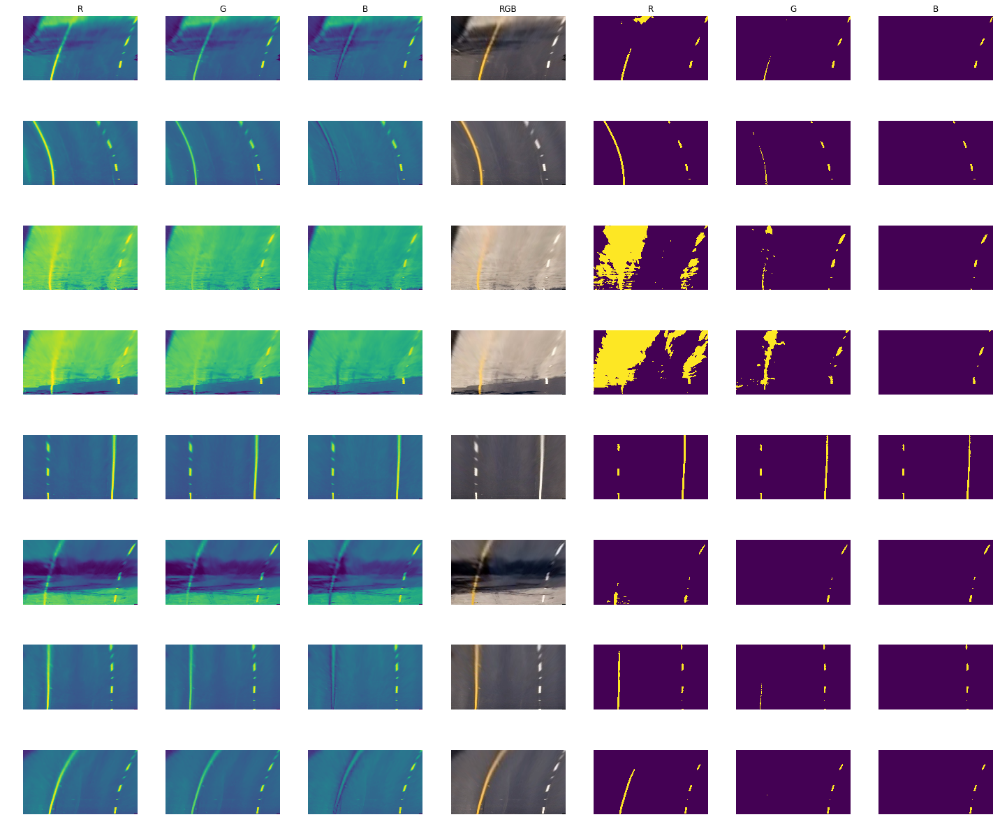

In [9]:
R_bins = []
G_bins = []
B_bins = []
fig, ax = plt.subplots(len(test_images), 7, figsize=(20,17))
rgb_col_labels = ['R','G','B','RGB','R','G','B']
for i, title in enumerate(rgb_col_labels):
    ax[0][i].set_title(title)
R_threshold = [200, 255]
G_threshold = [200, 255]
B_threshold = [200, 255]
for i, img in enumerate(topdown_images):
    #Conversion Threshold
    R_bin = threshold(img[:,:,0], R_threshold)
    R_bins.append(R_bin)
    G_bin = threshold(img[:,:,1], G_threshold)
    G_bins.append(G_bin)
    B_bin = threshold(img[:,:,2], B_threshold)
    B_bins.append(B_bin)
    plots = [img[:,:,0], img[:,:,1], img[:,:,2], img, R_bin, G_bin, B_bin]
    for ii, plot in enumerate(plots):
        ax[i][ii].imshow(plot)
        ax[i][ii].axis('off')
    
plt.tight_layout()
plt.savefig('./figs/RGB_images.png', bbox_inches='tight')

## LAB COnverison and Threshold

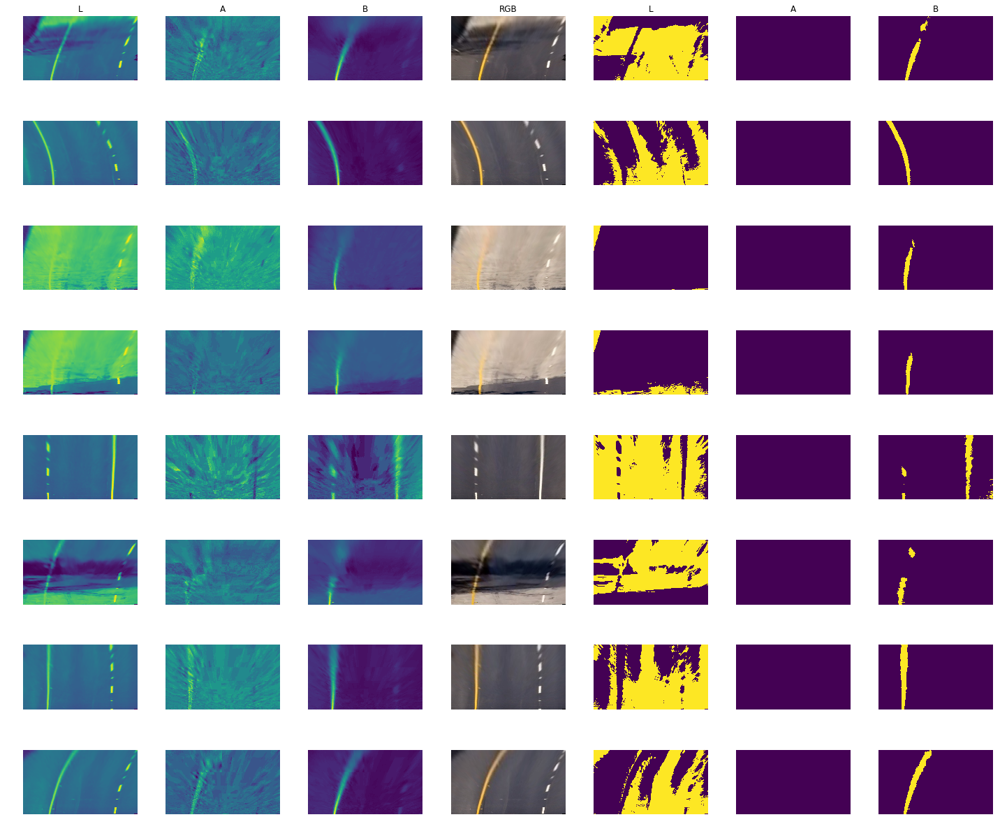

In [10]:
LAB_images = []
LL_bins = []
AA_bins = []
BB_bins = []
fig, ax = plt.subplots(len(test_images), 7, figsize=(20,17))
lab_col_labels = ['L','A','B','RGB','L','A','B']
for i, title in enumerate(lab_col_labels):
    ax[0][i].set_title(title)
LL_threshold = [15, 90]
AA_threshold = [210, 255]
BB_threshold = [140, 255]
for i, img in enumerate(topdown_images):
    #Conversion
    LAB = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
    LAB_images.append(LAB)
    
    
    #Threshold
    LL_bin = threshold(LAB[:,:,0], LL_threshold)
    LL_bins.append(LL_bin)
    AA_bin = threshold(LAB[:,:,1], AA_threshold)
    AA_bins.append(AA_bin)
    BB_threshold = gen_high_threshold(LAB[:,:,2], 2)
    BB_bin = threshold(LAB[:,:,2], BB_threshold, False)
    BB_bins.append(BB_bin)
    
    #Plot
    plots = [LAB[:,:,0], LAB[:,:,1], LAB[:,:,2], img, LL_bin, AA_bin, BB_bin]
    for ii, plot in enumerate(plots):
        ax[i][ii].imshow(plot)
        ax[i][ii].axis('off')
    
plt.tight_layout()
plt.savefig('./figs/LAB_images.png', bbox_inches='tight')

[ 125.  125.  125. ...,  128.  128.  128.]
129.358
8.70435


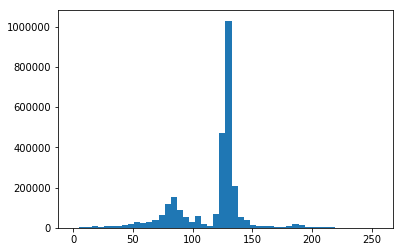

In [11]:
plt.figure()
asdf = LAB_images[0]
asdf2 = asdf[:,:,2]
asdf3 = np.float32(asdf2)
asdf4 = asdf3.flatten()
print(asdf4)
plt.figure()
plt.hist(asdf.flatten(), bins=50)
print(np.mean(asdf4))
print(np.std(asdf4))


## HLS Conversion and Thresholding

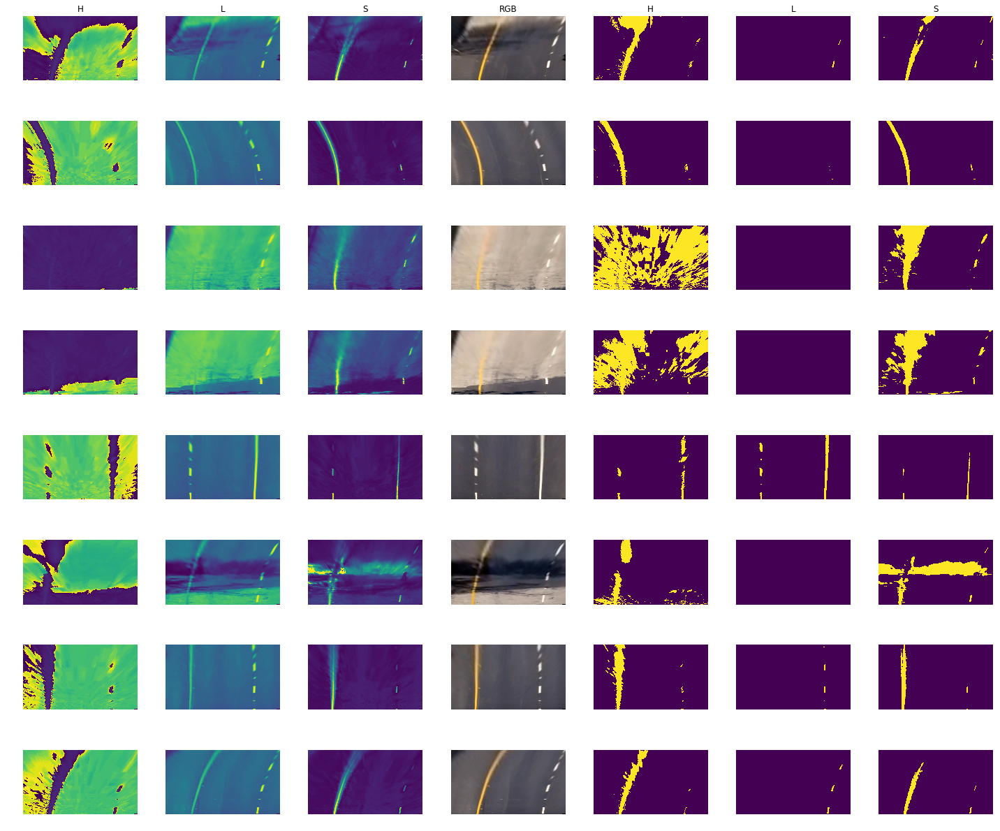

In [12]:
HLS_images = []
H_bins = []
L_bins = []
S_bins = []
fig, ax = plt.subplots(len(test_images), 7, figsize=(20,17))
hls_col_labels = ['H','L','S','RGB','H','L','S']
for i, title in enumerate(hls_col_labels):
    ax[0][i].set_title(title)
H_threshold = [15, 90]
L_threshold = [190, 255]
S_threshold = [80, 255]
for i, img in enumerate(topdown_images):
    #Conversion
    HLS = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    HLS_images.append(HLS)
    
    #Threshold
    H_bin = threshold(HLS[:,:,0], H_threshold)
    H_bins.append(H_bin)
    L_threshold = gen_high_threshold(HLS[:,:,2],8)
    L_bin = threshold(HLS[:,:,1], L_threshold)
    L_bins.append(L_bin)
    S_bin = threshold(HLS[:,:,2], S_threshold, True)
    S_bins.append(S_bin)
    
    #Plot
    plots = [HLS[:,:,0], HLS[:,:,1], HLS[:,:,2], img, H_bin, L_bin, S_bin]
    for ii, plot in enumerate(plots):
        ax[i][ii].imshow(plot)
        ax[i][ii].axis('off')
    
plt.tight_layout()
plt.savefig('./figs/HLS_images.png', bbox_inches='tight')


## YUV Conversion and Thresholding

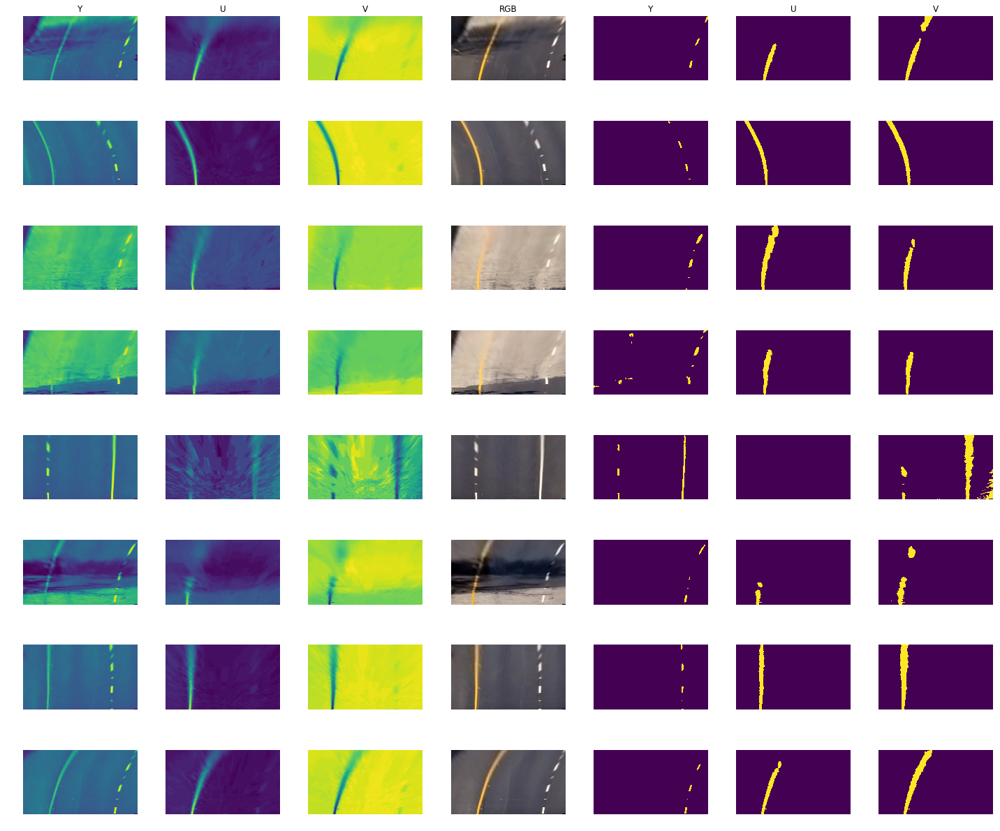

In [13]:
YUV_images = []
Y_bins = []
U_bins = []
V_bins = []
fig, ax = plt.subplots(len(test_images), 7, figsize=(20,17))
yuv_col_labels = ['Y','U','V','RGB','Y','U','V']
Y_threshold = [200, 255]
U_threshold = [145, 178]
V_threshold = [0, 120]
for i, title in enumerate(yuv_col_labels):
    ax[0][i].set_title(title)
for i, img in enumerate(topdown_images):
    #Conversion
    YUV = cv2.cvtColor(img, cv2.COLOR_RGB2YUV)
    YUV_images.append(YUV)    
    Y_bin = threshold(YUV[:,:,0], Y_threshold)
    Y_bins.append(Y_bin)
    u_min = np.amin(YUV[:,:,1])
    u_max = np.amax(YUV[:,:,1])
    U_bin = threshold(YUV[:,:,1], U_threshold, False)
    U_bins.append(U_bin)
    V_threshold = gen_low_threshold(YUV[:,:,2], 1.75)
    V_bin = threshold(YUV[:,:,2], V_threshold)
    V_bins.append(V_bin)
    
    plots = [YUV[:,:,0], YUV[:,:,1], YUV[:,:,2], img, Y_bin, U_bin, V_bin]
    for ii, plot in enumerate(plots):
        ax[i][ii].imshow(plot)
        ax[i][ii].axis('off')
    
plt.tight_layout()
plt.savefig('./figs/YUV_images.png', bbox_inches='tight')

## LUV Conversion and Thresholding

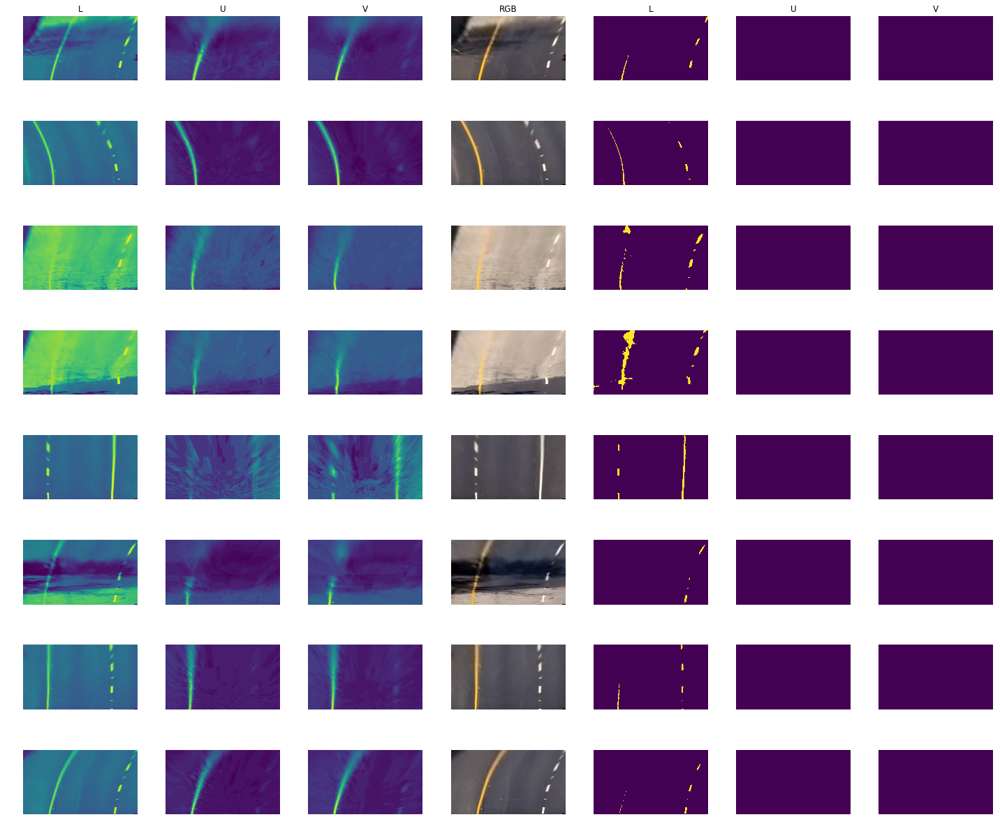

In [14]:
LUV_images = []
LLL_bins = []
UUU_bins = []
VVV_bins = []
fig, ax = plt.subplots(len(test_images), 7, figsize=(20,17))
luv_col_labels = ['L','U','V','RGB','L','U','V']
LLL_threshold = [210, 255]
UUU_threshold = [150, 178]
VVV_threshold = [0, 255]
for i, title in enumerate(luv_col_labels):
    ax[0][i].set_title(title)
for i, img in enumerate(topdown_images):
    #Conversion
    LUV = cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
    LUV_images.append(LUV)    
    LLL_bin = threshold(LUV[:,:,0], LLL_threshold)
    LLL_bins.append(LLL_bin)
    UUU_bin = threshold(LUV[:,:,1], UUU_threshold, False)
    UUU_bins.append(UUU_bin)
    VVV_bin = threshold(LUV[:,:,2], VVV_threshold, False)
    VVV_bins.append(VVV_bin)
    
    plots = [LUV[:,:,0], LUV[:,:,1], LUV[:,:,2], img, LLL_bin, UUU_bin, VVV_bin]
    for ii, plot in enumerate(plots):
        ax[i][ii].imshow(plot)
        ax[i][ii].axis('off')
    
plt.tight_layout()
plt.savefig('./figs/LUV_images.png', bbox_inches='tight')

[ 37.  37.  37. ...,   0.   0.   0.]
129.358
8.70435


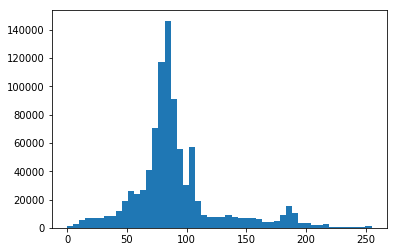

In [15]:
plt.figure()
asdf = LUV_images[0]
asdf2 = np.float32(asdf[:,:,0]).flatten()
print(asdf2)
plt.figure()
plt.hist(asdf2, bins=50)
print(np.mean(asdf4))
print(np.std(asdf4))

## SOBEL Conversion and Threshold

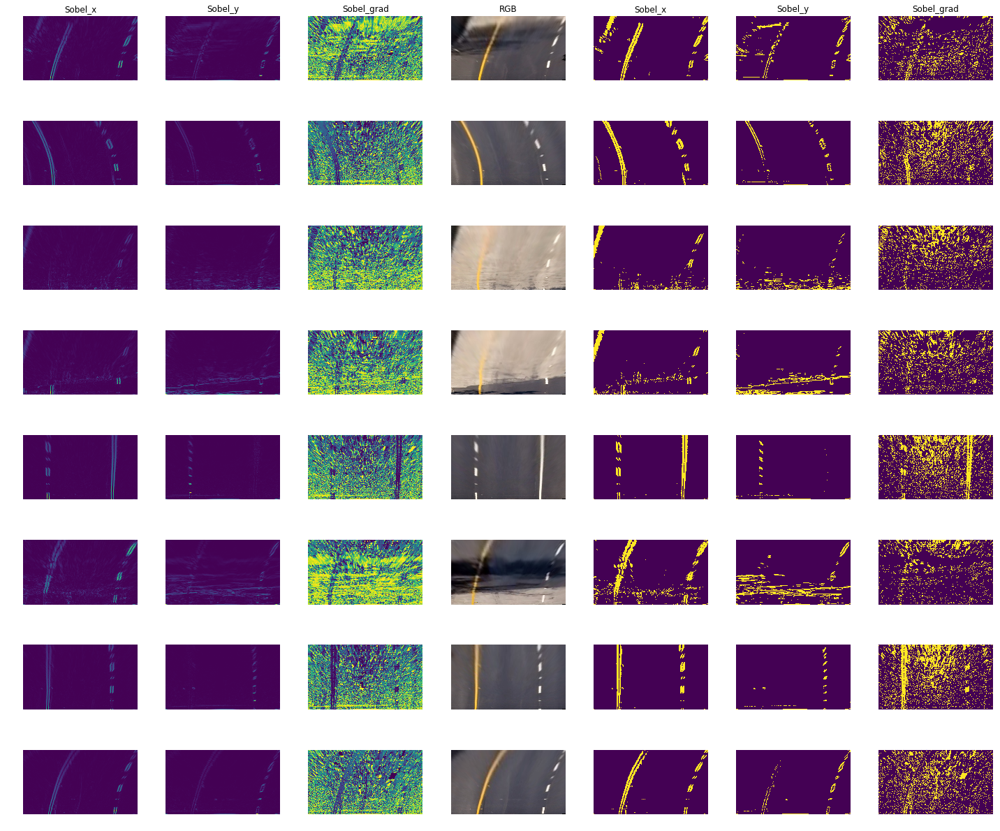

In [16]:
SOB_images = []
SX_bins = []
SY_bins = []
SG_bins = []
fig, ax = plt.subplots(len(test_images), 7, figsize=(20,17))
hls_col_labels = ['Sobel_x','Sobel_y','Sobel_grad','RGB','Sobel_x','Sobel_y','Sobel_grad']
SX_threshold = [15, 255]
SY_threshold = [15, 255]
SG_threshold = [0, 0.3]
for i, title in enumerate(hls_col_labels):
    ax[0][i].set_title(title)
for i, img in enumerate(topdown_images):
    #Conversion
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobx = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=15))
    soby = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=15))
    sobelg = np.arctan2(soby, sobx)
    sobelx = np.uint8(255*sobx/np.max(sobx))
    sobely = np.uint8(255*soby/np.max(soby))
    SOB_images.append(sobelx)
    #Threshold
    SX_bin = threshold(sobelx, SX_threshold)
    SX_bins.append(SX_bin)
    SY_bin = threshold(sobely, SY_threshold)
    SY_bins.append(SY_bin)
    SG_bin = threshold(sobelg, SG_threshold)
    SG_bins.append(SG_bin)
    
    #Plot
    plots = [sobelx, sobely, sobelg, img, SX_bin, SY_bin, SG_bin]
    for ii, plot in enumerate(plots):
        ax[i][ii].imshow(plot)
        ax[i][ii].axis('off')
    
plt.tight_layout()
plt.savefig('./figs/SOB_images.png', bbox_inches='tight')

## Binary Threshold Conversion

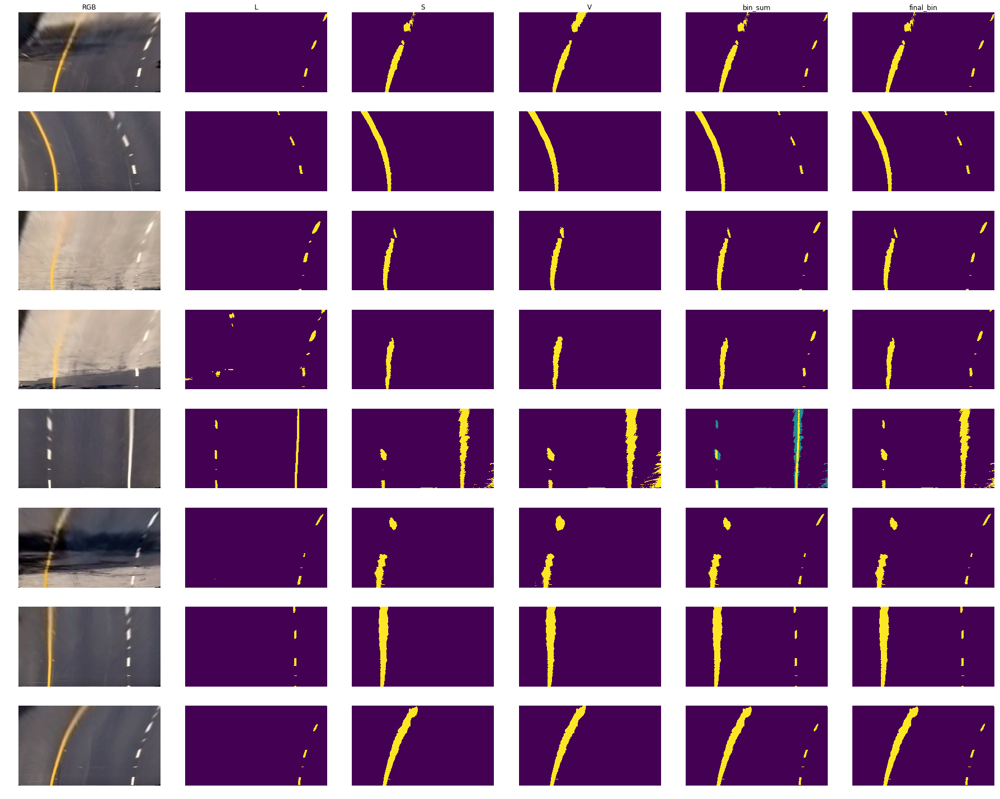

In [17]:
Final_bins = []
fig, ax = plt.subplots(len(test_images), 6, figsize=(25,20))
#hls_col_labels = ['RGB','G','Y','U','V','Sobel_x','bin_sum', 'final_bin']
hls_col_labels = ['RGB', 'L', 'S','V', 'bin_sum', 'final_bin']
bin_threshold = [1.0, 255]
for i, title in enumerate(hls_col_labels):
    ax[0][i].set_title(title)

for i, img in enumerate(topdown_images):
    #Conversion
    #bin_sum = 0.5*G_bins[i] + 1.0*Y_bins[i] + 0.5*U_bins[i] + \
    #          0.5*V_bins[i] + 0.75*SX_bins[i] + 1.0*S_bins[i]  
    bin_sum = BB_bins[i]+ B_bins[i]
    #bin_sum = Y_bins[i] + BB_bins[i]
    
    #bin_sum = 0.5*G_bin + 1.0*Y_bin + 0.5*U_bin + 0.5*V_bin + 0.75*SX_bin + S_bin
    #Threshold
    final_bin = threshold(bin_sum, bin_threshold)
    Final_bins.append(final_bin)
    #Plot
    #plots = [img, G_bins[i], Y_bins[i], U_bins[i], V_bins[i], SX_bins[i], bin_sum, final_bin]
    plots = [img, Y_bins[i], BB_bins[i], V_bins[i], bin_sum, final_bin]
    for ii, plot in enumerate(plots):
        ax[i][ii].imshow(plot)
        ax[i][ii].axis('off')
    
plt.tight_layout()
plt.savefig('./figs/Bin_images.png', bbox_inches='tight')

## Lane Finding Algorithm

In [18]:
def line_find(binary_warped, bool_newline=[True, True], line_fit_prev=[]):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[360:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        if bool_newline[0]:
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin
            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
            (0,255,0), 2) 
            # Identify the nonzero pixels in x and y within the window
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            # If you found > minpix pixels, recenter next window on their mean position
            if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if bool_newline[1]:
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin
            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
            (0,255,0), 2) 
            # Identify the nonzero pixels in x and y within the window
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
            # Append these indices to the lists
            right_lane_inds.append(good_right_inds)
            # If you found > minpix pixels, recenter next window on their mean position
            if len(good_right_inds) > minpix:        
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    if bool_newline[0]:
        left_lane_inds = np.concatenate(left_lane_inds)
    else:
        left_fit = line_fit_prev[0]
        left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
        left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
        left_fit[1]*nonzeroy + left_fit[2] + margin))) 
        
    if bool_newline[1]:
        right_lane_inds = np.concatenate(right_lane_inds)
    else:
        right_fit = line_fit_prev[1]
        right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
        right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
        right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fit = np.polyfit(righty, rightx, 2)
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    line_fit = [left_fit, right_fit]
    line_fitx = [left_fitx, right_fitx]
    
    lane_pts = [nonzeroy[left_lane_inds], nonzerox[left_lane_inds],
                nonzeroy[right_lane_inds], nonzerox[right_lane_inds]]
                
    #Left Confidence
    left_num_bin_pts = np.sum(binary_warped[:,:640])
    if bool_newline[0]:
        left_conf = len(left_lane_inds)/left_num_bin_pts
    else:
        left_line_mask = np.zeros_like(binary_warped)
        for y, x in enumerate(left_fitx):
            x_ind_begin = max(0, np.int_(x-margin))
            x_ind_end = min(np.int(x+margin), 1280)
            left_line_mask[y,x_ind_begin:x_ind_end] = 1
        left_conf = np.sum(np.logical_and(left_line_mask, binary_warped))/left_num_bin_pts
    
    #Right Confidence
    right_num_bin_pts = np.sum(binary_warped[:,640:])
    if bool_newline[1]:
        right_conf = len(right_lane_inds)/right_num_bin_pts
    else:
        right_line_mask = np.zeros_like(binary_warped)
        for y, x in enumerate(right_fitx):
            x_ind_begin = max(0, np.int_(x-margin))
            x_ind_end = min(np.int(x+margin), 1280)
            right_line_mask[y,x_ind_begin:x_ind_end] = 1
        right_conf = np.sum(np.logical_and(right_line_mask, binary_warped))/right_num_bin_pts
    
    conf = [left_conf, right_conf]
    return line_fit, line_fitx, lane_pts, conf


ploty = np.linspace(0, N-1, N)
def gen_poly_line(left_fit, right_fit):
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    return left_fitx, right_fitx

In [19]:
line_fit, line_fitx, lane_pts, conf = line_find(Final_bins[1])
print(conf)
line_fit, line_fitx, lane_pts, conf  = line_find(Final_bins[1],[False, False],line_fit) 
print(conf)
print(len(lane_pts))

[1.0, 0.8626492942453855]
[1.0, 1.0]
4


(720, 0)

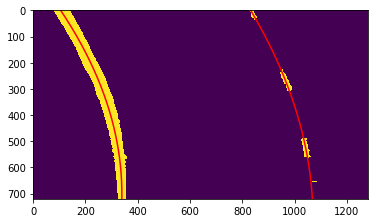

In [20]:
#out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
#out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
plt.imshow(Final_bins[1])
plt.plot(line_fitx[0], ploty, color='red')
plt.plot(line_fitx[1], ploty, color='red')
plt.xlim(0, 1280)
plt.ylim(720, 0)

(720, 0)

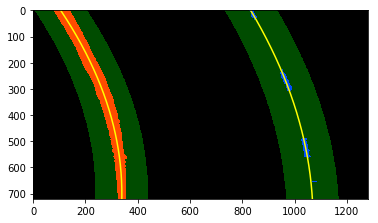

In [21]:
def result_plot(binary_warped, line_fitx, lane_pts):
    left_fitx = line_fitx[0]
    right_fitx = line_fitx[1]
    # Create an image to draw on and an image to show the selection window
    #binary_warped = np.uint8(Final_bins[1])
    out_img = np.uint8(np.dstack((binary_warped, binary_warped, binary_warped))*255)
    window_img = np.zeros_like(out_img)

    # Color in left and right line pixels
    out_img[lane_pts[0], lane_pts[1]] = [255, 0, 0]
    out_img[lane_pts[2], lane_pts[3]] = [0, 0, 255]

    margin = 100
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                                  ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                                  ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    return result

result = result_plot(Final_bins[1],line_fitx, lane_pts)
plt.imshow(result)
plt.plot(line_fitx[0], ploty, color='yellow')
plt.plot(line_fitx[1], ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

## Curvature and Center Offset

In [22]:
#Curvature Measurement
def curvature(line_fit):
    left_fit = line_fit[0]
    right_fit = line_fit[1]
    
    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 10/270 # meters per pixel in y dimension
    xm_per_pix = 3.7/720 # meters per pixel in x dimension
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit[0]*y_eval*ym_per_pix + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval*ym_per_pix + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    # Now our radius of curvature is in meters
    return left_curverad, right_curverad
    # Example values: 632.1 m    626.2 m

    
def center_offset(line_fitx):
    xm_per_pix = 3.7/720
    left_offset = line_fitx[0][-1]
    right_offset = line_fitx[1][-1]
    left_center_offset = 640 - left_offset
    right_center_offset = right_offset - 640
    center_offset = abs(left_center_offset - right_center_offset)*xm_per_pix/2
    if left_center_offset < right_center_offset:
        
        return center_offset, True
    else:
        center_offset = 0
        return center_offset, False
        


test_curve = curvature(line_fit)
test_center = center_offset(line_fitx)
    

print(test_curve)
print(test_center)

(1761.6546742585485, 2063.3716837897723)
(0.32629884609752058, True)


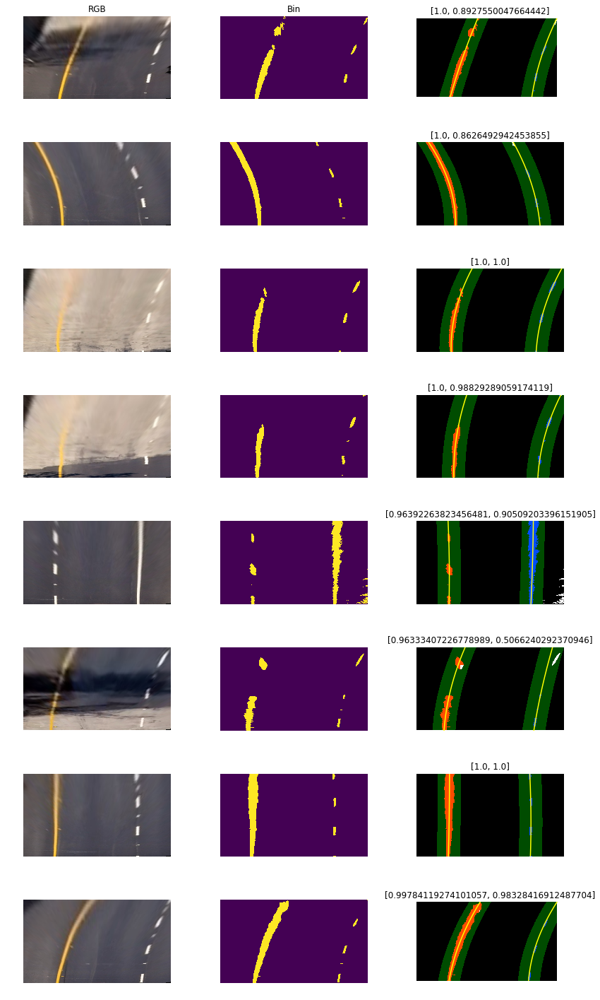

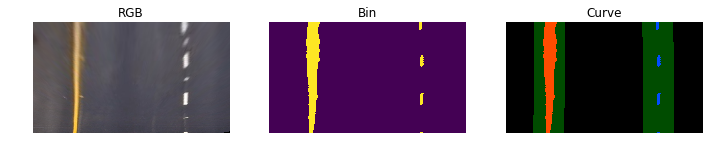

In [23]:
Result_images = []
line_fits = []
line_fitxs = []
fig, ax = plt.subplots(len(test_images), 3, figsize=(12,20))
hls_col_labels = ['RGB','Bin','Curve']
for i, title in enumerate(hls_col_labels):
    ax[0][i].set_title(title)

for i, img in enumerate(Final_bins):
    #Conversion
    line_fit, line_fitx, lane_pts, conf = line_find(img)
    result_img = result_plot(img,line_fitx, lane_pts)
    Result_images.append(result_img)
    line_fits.append(line_fit)
    line_fitxs.append(line_fitx)
    
    #Plot
    plots = [topdown_images[i], img, result_img]
    for ii, plot in enumerate(plots):
        ax[i][ii].imshow(plot)
        ax[i][ii].axis('off')
        if ii == 2:
            ax[i][ii].plot(line_fitx[0], ploty, color='yellow')
            ax[i][ii].plot(line_fitx[1], ploty, color='yellow')
            ax[i][ii].set_title(str(conf))
    
plt.tight_layout()
plt.savefig('./figs/Curve_images.png', bbox_inches='tight')


plt.figure()
fig2, ax2 = plt.subplots(1, 3, figsize=(10,3))
hls_col_labels = ['RGB','Bin','Curve']
for i, title in enumerate(hls_col_labels):
    ax2[i].set_title(title)
    
ax2[0].imshow(topdown_images[6] )
ax2[0].axis('off')
ax2[1].imshow(Final_bins[6])
ax2[1].axis('off')
ax2[2].imshow(Result_images[6])
ax2[2].axis('off')
plt.tight_layout()
plt.savefig('./figs/lane_find.png')

## Reverse transform with lane overlay

In [24]:
def new_warp(line_fitx):
    # Create an image to draw the lines on
    color_warp = np.zeros_like(test_images[0]).astype(np.uint8)
    #color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([line_fitx[0], ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([line_fitx[1], ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    ret = cv2.warpPerspective(color_warp, MtransformInv, (image.shape[1], image.shape[0])) 
    return ret

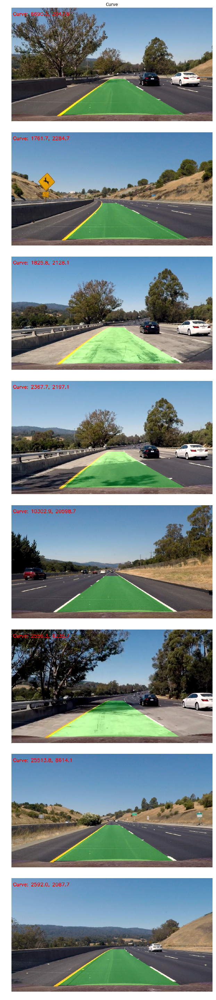

In [25]:
#Final_bins = []
fig, ax = plt.subplots(len(test_images),1, figsize=(10,40))
ax[0].set_title('Curve')

for i, img in enumerate(test_images):
    #Conversion
    newwarp = new_warp(line_fitxs[i])
    drawn_image = cv2.addWeighted(img, 1, newwarp, 0.3, 0) 
    font = cv2.FONT_HERSHEY_SIMPLEX
    curve = curvature(line_fits[i])
    cv2.putText(drawn_image,'Curve: %0.1f, %0.1f' % (curve[0], curve[1]) \
                , (10, 50), font, 1, (255,0,0),2,cv2.LINE_AA )
    
    #Plot
    ax[i].imshow(drawn_image)
    ax[i].axis('off')
    
plt.tight_layout()
plt.savefig('./figs/Final_images.png', bbox_inches='tight')

## Pipeline

In [26]:
def pipeline(image):
    test_image_size = image.shape[1::-1]
    #Calibrate
    undist = undistort_image(image)
    
    #Perspective Transform
    top_down = perspective_transform(undist, test_image_size, Mtransform) 
    
    #print(top_down.shape)
    #Color conversion/thresholding
#     G_bin = threshold(top_down[:,:,1], G_threshold)
    B_bin = threshold(top_down[:,:,2], B_threshold)
    
#     HLS = cv2.cvtColor(top_down, cv2.COLOR_RGB2HLS)
#     H_bin = threshold(HLS[:,:,0], H_threshold)
#     L_bin = threshold(HLS[:,:,1], L_threshold)
#     S_bin = threshold(HLS[:,:,2], S_threshold)
    
#     YUV = cv2.cvtColor(top_down, cv2.COLOR_RGB2YUV)
#     Y_bin = threshold(YUV[:,:,0], Y_threshold)
#     U_bin = threshold(YUV[:,:,1], U_threshold)
#     V_bin = threshold(YUV[:,:,2], V_threshold)
    
#     gray = cv2.cvtColor(top_down, cv2.COLOR_RGB2GRAY)
#     sobx = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=15))
#     sobelx = np.uint8(255*sobx/np.max(sobx))
#     SX_bin = threshold(sobelx, SX_threshold)
    
    LAB = cv2.cvtColor(top_down, cv2.COLOR_RGB2LAB)
    BB_threshold = gen_high_threshold(LAB[:,:,2], 2)
    BB_bin = threshold(LAB[:,:,2], BB_threshold, False)
    
    bin_threshold = [0.9, 255]
    #Binary output
    #bin_sum = 0.5*G_bin + 1.0*Y_bin + 0.5*U_bin + 0.5*V_bin + 0.3*SX_bin + S_bin
    bin_sum = BB_bin + B_bin
    
    # Calculate line
    line_fit, line_fitx, lane_pts,conf  = line_find(bin_sum) 
    
    # Overlay
    newwarp = new_warp(gen_poly_line(line_fit[0], line_fit[1]))
    drawn_image = cv2.addWeighted(undist, 1, newwarp, 0.3, 0) 
    
    font = cv2.FONT_HERSHEY_SIMPLEX
    curve = curvature(line_fit)
    cv2.putText(drawn_image,'Curve: %0.2f, %0.2f' % (curve[0], curve[1]) \
                , (10, 50), font, 1, (255,0,0),2,cv2.LINE_AA )
    
    center_off, direction = center_offset(line_fitx)
    if direction:
        center_text = 'Center: %0.3fm from left' % center_off
    else:
        center_text = 'Center: %0.3fm from right' % center_off
    cv2.putText(drawn_image,center_text, (10, 100), font, 1, (255,0,0),2,cv2.LINE_AA )
    
    return drawn_image

In [27]:
def process_image(image):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    # you should return the final output (image where lines are drawn on lanes)
    result = pipeline(image)
    return result

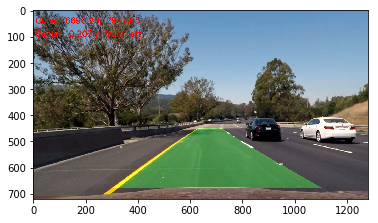

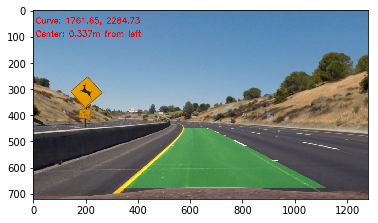

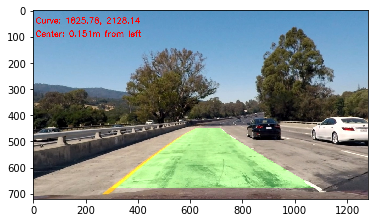

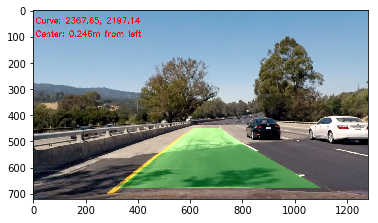

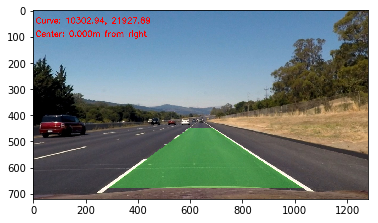

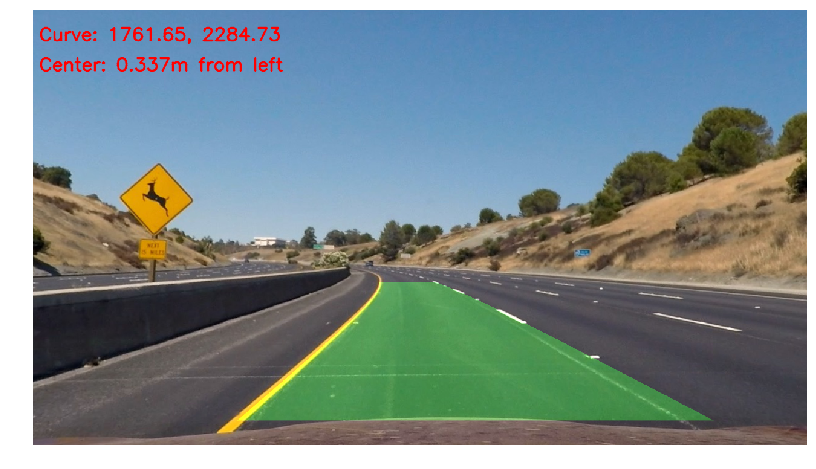

In [28]:
left_lane = Line()
right_lane = Line()
asdf = process_image(test_images[0])
plt.figure();
plt.imshow(asdf)
asdf = process_image(test_images[1])
plt.figure();
plt.imshow(asdf)
asdf = process_image(test_images[2])
plt.figure();
plt.imshow(asdf)
asdf = process_image(test_images[3])
plt.figure();
plt.imshow(asdf)
asdf = process_image(test_images[4])
plt.figure();
plt.imshow(asdf)
asdf = process_image(test_images[1])
plt.figure();

fig, ax = plt.subplots(1, figsize=[14,8])

ax.axis('off')
plt.imshow(asdf)

plt.savefig('./figs/lane_curve_center.png')


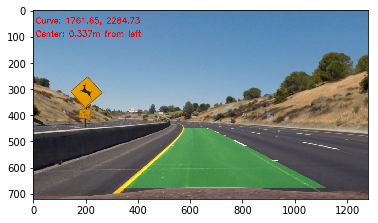

In [ ]:
# Import everything needed to edit/save/watch video clips
asdf = process_image(test_images[1])
plt.figure;
plt.imshow(asdf)
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [ ]:
output_video = 'project_video_output.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
#clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("project_video.mp4")
left_lane = Line()
right_lane = Line()
output_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time output_clip.write_videofile(output_video, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


 80%|████████  | 1015/1261 [01:20<00:20, 12.21it/s]

In [ ]:
HTML("""
<video width="1280" height="720" controls>
  <source src="{0}">
</video>
""".format(output_video))